In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots

# Bronze layer

In [2]:
# Check bronze layer
df = pd.read_pickle('data/bronze/df.pickle')
assert df.index.is_unique
print(df.index.min(), ' -> ', df.index.max())
df.tail(3)

2015-01-01 00:00:00+01:00  ->  2024-10-19 11:00:00+02:00


,Forecasted Load,Actual Load
2024-10-19 09:00:00+02:00,6660.0,NaN
2024-10-19 10:00:00+02:00,7476.0,NaN
2024-10-19 11:00:00+02:00,7805.0,NaN


In [3]:
# Plot the full bronze data
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, subplot_titles=("Actual Load", "Forecasted Load"))
fig.add_trace(
    px.line(df.reset_index(), x='index', y='Actual Load').data[0],
    row=1, col=1
)
fig.add_trace(
    px.line(df.reset_index(), x='index', y='Forecasted Load').data[0],
    row=2, col=1
)

In [4]:
# Plot the last 48 entries of the bronze data
df = df.iloc[-48:]

fig = make_subplots(rows=2, cols=1, shared_xaxes=True, subplot_titles=("Actual Load", "Forecasted Load"))
fig.add_trace(
    px.line(df.reset_index(), x='index', y='Actual Load').data[0],
    row=1, col=1
)
fig.add_trace(
    px.line(df.reset_index(), x='index', y='Forecasted Load').data[0],
    row=2, col=1
)

- The Forecasted Load should be ranging 48h
- The Actual Load should only have 24 values
- The latest Actual Load value should have a timestamp corresponding to the datetime of the last locally-run `\update-forecast`

# Silver layer

In [5]:
# Check silver layer
df = pd.read_pickle('data/silver/df.pickle')
assert df.index.is_unique
print(df.index.min(), ' -> ', df.index.max())
df.tail(3)

2014-12-31 00:00:00+01:00  ->  2024-10-18 11:00:00+02:00


,24h_later_forecast,24h_later_load
2024-10-18 09:00:00+02:00,6660.0,NaN
2024-10-18 10:00:00+02:00,7476.0,NaN
2024-10-18 11:00:00+02:00,7805.0,NaN


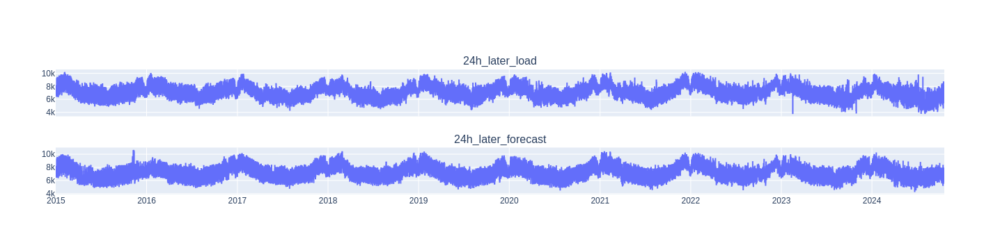

In [6]:
# Plot the full silver data
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, subplot_titles=("24h_later_load", "24h_later_forecast"))
fig.add_trace(
    px.line(df.reset_index(), x='index', y='24h_later_load').data[0],
    row=1, col=1
)
fig.add_trace(
    px.line(df.reset_index(), x='index', y='24h_later_forecast').data[0],
    row=2, col=1
)

In [7]:
# Plot the last 48 entries of the silver data
df = df.iloc[-48:]

fig = make_subplots(rows=2, cols=1, shared_xaxes=True, subplot_titles=("24h_later_load", "24h_later_forecast"))
fig.add_trace(
    px.line(df.reset_index(), x='index', y='24h_later_load').data[0],
    row=1, col=1
)
fig.add_trace(
    px.line(df.reset_index(), x='index', y='24h_later_forecast').data[0],
    row=2, col=1
)

- The 24h_later_forecast should be ranging 48h
- The 24h_later_load should only have 24 values
- The latest 24h_later_load value should have a timestamp corresponding to the datetime of the last locally-run `\update-forecast`, minus 24h

# Gold layer

In [8]:
# Check gold layer
df = pd.read_pickle('data/gold/df.pickle')
assert df.index.is_unique
print(df.index.min(), ' -> ', df.index.max())
df.tail(3)

2014-12-31 00:00:00+01:00  ->  2024-10-18 11:00:00+02:00


,24h_later_forecast,24h_later_load,year,month,day,hour,weekday,1h_ago_load,2h_ago_load,3h_ago_load,...,7d_ago_load,8h_min,8h_max,8h_median,24h_min,24h_max,24h_median,7d_min,7d_max,7d_median
2024-10-18 09:00:00+02:00,6660.0,NaN,2024,10,18,9,4,7504.0,7377.0,6810.0,...,7037.0,5383.0,7504.0,6870.0,5383.0,7709.0,6867.0,4580.0,8763.0,6532.0
2024-10-18 10:00:00+02:00,7476.0,NaN,2024,10,18,10,4,7363.0,7504.0,7377.0,...,6898.0,5965.0,7504.0,6939.5,5383.0,7681.0,6867.0,4580.0,8763.0,6532.0
2024-10-18 11:00:00+02:00,7805.0,NaN,2024,10,18,11,4,6381.0,7363.0,7504.0,...,6936.0,5965.0,7504.0,6879.5,5383.0,7681.0,6867.0,4580.0,8763.0,6518.0


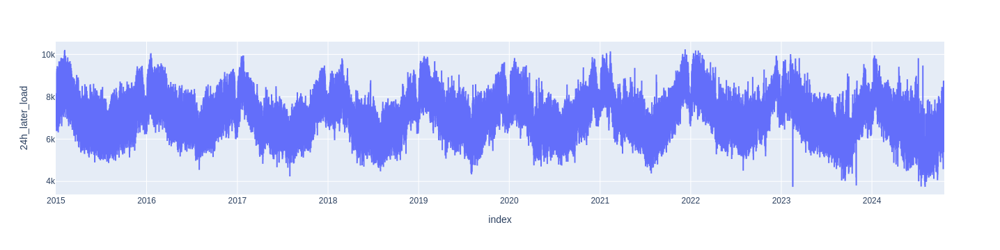

In [9]:
# Plot the full gold data
px.line(df.reset_index(), x='index', y='24h_later_load')

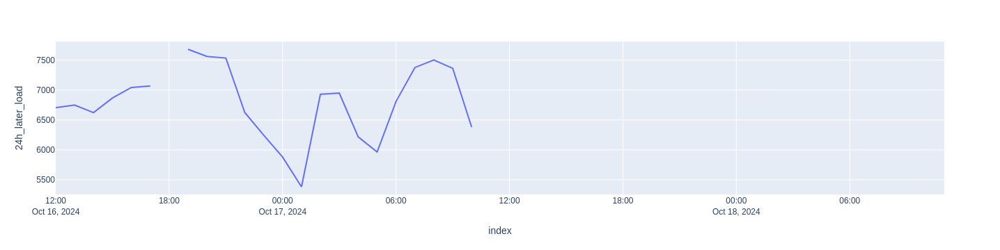

In [10]:
# Plot the last 48 entries of the gold data
df = df.iloc[-48:]
px.line(df.reset_index(), x='index', y='24h_later_load')

# Predictions

In [11]:
# Check yhat
df = pd.read_pickle('data/yhat.pickle')
assert df.index.is_unique
assert len(df)
print(df.index.min(), ' -> ', df.index.max())
df.head(3)

2024-10-01 00:00:00+02:00  ->  2024-10-01 23:00:00+02:00


,predicted_24h_later_load
2024-10-01 00:00:00+02:00,6050.943238
2024-10-01 01:00:00+02:00,6316.283137
2024-10-01 02:00:00+02:00,6259.333145


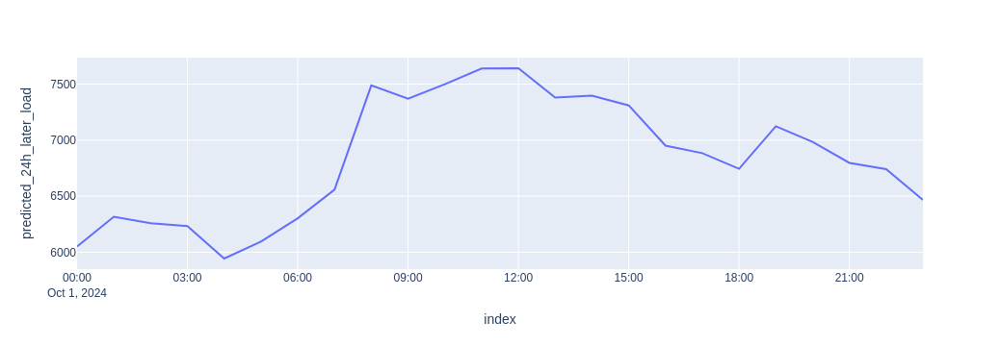

In [12]:
px.line(df.reset_index(), x='index', y='predicted_24h_later_load')